# World happiness report - data analysis & prediction

__Goal of this project:__
* Understand what country-level metrics correlates with life ladder (i.e. the happiness) score from the World Happiness Report
* See what correlation exists independently from the country's income level classified by The World Bank. In other words, what can raise/lower happiness that can't be solved by money
* Attempt prediction of the life ladder based on data separate from world happiness report

## Documentation

### Hypothetical scenario for the analysis
An illustration of vague (but happens all the time) analysis scenario:

You are an analyst for a non-profit organization that works with a few western (mostly first world) countries as an outside consultant to advise on ways to increase citizen's happiness. Though it's a small organization, ability to provide objective opinion across countires (without political intervention) is deemed valuable. 

You are being tasked to do an analysis of the [World Happiness Report](https://happiness-report.s3.amazonaws.com/2024/WHR+24.pdf). Though the report provides valuable insights by itself, the clients something more tailored to their needs to take action. Here are a few opinions provided by the clients
* The report is not clear how much money plays a role in terms of happiness, especially in comparison with other subjective surveys (e.g. social support, positiveness). 
* If there are any particular insights for the first world countries.
* If there are any particular action items that government bodies can possibly take, based on the survey. 

You are tasked to provide a deeper analysis of the world happiness report by using its [raw data](https://worldhappiness.report/data/), but possibly utilizing other open data to come up with an analysis report for the clients that answers the questions stated above. 

### Approach

Here's the general analysis approach: 
* Find and import country-level statistical data/metrics that can be utilized for analysis. Main source is from The World Bank
* Join the World Happiness Report (WHP) data with external data to run correlation analysis (OLS) and regression analysis. Focus is to find if there are any other metrics that highly correlates with the happiness score (i.e. Life Ladder)
* Compare the result above with similar analysis done per income group (defined by The World Bank), to see if there are noticeable differences in correlation between income groups. 
* Do specific analysis for high income group to see if there are additional insights that can be pulled. 

_Note that the steps mentioned above is the initial approach, and the steps have changed in the actual research implementation below_

## Initialize

In [110]:
import pandas as pd
from itables import init_notebook_mode
from itables import show
import matplotlib.pyplot as plt
import seaborn as sns
import math
import numpy as np
from textwrap import wrap
import numpy.polynomial as poly

In [111]:
#Mapping dictionaries for renaming 
column_renames = {
    '2012 [YR2012]':'2012',
    '2013 [YR2013]':'2013',
    '2014 [YR2014]':'2014',
    '2015 [YR2015]':'2015',
    '2016 [YR2016]':'2016',
    '2017 [YR2017]':'2017',
    '2018 [YR2018]':'2018',
    '2019 [YR2019]':'2019',
    '2020 [YR2020]':'2020',
    '2021 [YR2021]':'2021',
    '2022 [YR2022]':'2022',
    '2023 [YR2023]':'2023',
    'Series Name': 'series',
    'Year': 'year',
    'Country Name': 'country',
    'Country name': 'country',
    'Country': 'country'
}    

income_rename = {
    'H': 'High',
    'UM': 'U-mid',
    'LM': 'L-mid',
    'LM*': 'L-mid',
    'L': 'Low',
    '..':None
}

#Used for graphing and analysis
incomes = ['High','U-mid','L-mid','Low']

In [112]:
# Source data information
data_folder = 'data/'

world_happiness_file = 'world_happiness.csv'
wdi_1_file = 'WDI_data_1.csv'
wdi_2_file = 'WDI_data_2.csv'
nutrition_population_file = 'nutrition-population_Data.csv'
natural_disasters_file = 'natural-disasters.csv'
food_prices_file = 'food-prices_Data.csv'
ccdr_file = 'CCDR_Data.csv'
country_classification_file = 'WorldData_country_classify.csv' #Note that this csv file has been manually editted for country renaming purposes

## Import & process source data
__General steps taken:__
* Import source csv files as dataframes
* Rename common column names for later merging
* Denormalize all dataframes 
* Merge all dataframes
* Create pivotted dataframe with countries in rows and metrics in columns

In [114]:
#Import into dataframes
world_happiness_df = pd.read_csv(data_folder +world_happiness_file)
wdi_1_df = pd.read_csv(data_folder +wdi_1_file)
wdi_2_df = pd.read_csv(data_folder +wdi_2_file)
nutrition_population_df = pd.read_csv(data_folder +nutrition_population_file)
natural_disasters_df = pd.read_csv(data_folder +natural_disasters_file)
food_prices_df = pd.read_csv(data_folder +food_prices_file)
ccdr_df = pd.read_csv(data_folder +ccdr_file)
country_classify_df = pd.read_csv(data_folder +country_classification_file)

In [115]:
#Column renaming and massaging (denormalizing). Steps are different for each source file

#World happiness 
world_happiness_df = world_happiness_df.rename(columns=column_renames).melt(id_vars=['country','year'],var_name='series',value_name='value')
world_happiness_df['source'] = 'World happiness'

#Natural disasters
natural_disasters_df = natural_disasters_df.rename(columns=column_renames).melt(id_vars=['country','year'],var_name='series',value_name='value')
natural_disasters_df['source'] = 'Natural disaster'

#World Development Indicators 1 + 2 then concat
if ('Country Code' in wdi_1_df.columns) and 'Series Code' in wdi_1_df.columns:
    wdi_1_df.drop(columns=['Series Code','Country Code'],inplace=True)
wdi_1_df = wdi_1_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')

if ('Country Code' in wdi_2_df.columns) and 'Series Code' in wdi_2_df.columns:
    wdi_2_df.drop(columns=['Series Code','Country Code'],inplace=True)
wdi_2_df = wdi_2_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')

wdi_df = pd.concat([wdi_1_df,wdi_2_df],axis=0)
wdi_df['source'] = 'WDI'



#Nutrition & populate data
if ('Country Code' in nutrition_population_df.columns) and 'Series Code' in nutrition_population_df.columns:
    nutrition_population_df.drop(columns=['Series Code','Country Code'],inplace=True)
nutrition_population_df = nutrition_population_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')
nutrition_population_df['source'] = 'Nutrition population'

#Food prices
if ('Country Code' in food_prices_df.columns) and 'Series Code' in food_prices_df.columns:
    food_prices_df.drop(columns=['Series Code','Country Code'],inplace=True)
if ('Classification Code' in food_prices_df.columns) and 'Classification Name' in food_prices_df.columns:
    food_prices_df.drop(columns=['Classification Code','Classification Name'],inplace=True)
food_prices_df = food_prices_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')
food_prices_df['source'] = 'Food prices'

#Country Climate and Development Reports 
if ('Country Code' in ccdr_df.columns) and 'Series Code' in ccdr_df.columns:
    ccdr_df.drop(columns=['Series Code','Country Code'],inplace=True)
ccdr_df = ccdr_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')
ccdr_df['source'] = 'CCDR'

#Country classification data, includes income level and region
country_classify_df = pd.read_csv(data_folder +country_classification_file)
country_classify_df = country_classify_df.melt(id_vars=['Country'],var_name='year',value_name='Income group').rename(columns=column_renames)
country_classify_df['Income group'] = country_classify_df['Income group'].dropna().map(lambda x: income_rename[x])
country_classify_df.dropna(inplace=True)
country_classify_df['year'] = pd.to_numeric(country_classify_df['year'])
#Country classification doesn't exist for 2023 yet. So, we will use the 2022 classifications 
country_classify_df_2023 = country_classify_df.loc[country_classify_df['year']==2022,['country','Income group']]
country_classify_df_2023['year'] = 2023
country_classify_df = pd.concat([country_classify_df,country_classify_df_2023],axis=0)

In [116]:
#Merge all (except for country classification) into one dataframe as a denormalized dataframe
denorm_df = pd.concat(
    [world_happiness_df,
     natural_disasters_df,
     wdi_df,
     nutrition_population_df,
     food_prices_df,
     ccdr_df], axis=0)

#Clean up NaN data 
denorm_df = denorm_df.dropna()
denorm_df = denorm_df.loc[~denorm_df['country'].isna(),:]
denorm_df = denorm_df.loc[denorm_df['value'] != '..']
denorm_df = denorm_df.drop_duplicates()
#There are duplicate entries with different values coming from different data sources. There isn't a clear way to identify which 
#data source is correct. For now, using the 'first' data
denorm_df = denorm_df.drop_duplicates(subset=['country','year','series'],keep='first')

#Make value and year numeric
denorm_df['value'] =  pd.to_numeric(denorm_df['value'])
denorm_df['year'] =  pd.to_numeric(denorm_df['year'])

In [117]:
#Create pivotted dataframe. Rows are aggregated by country and year. Each column consists of metric
pivot_df = denorm_df.pivot_table(columns=['series'],index=['country','year'],values=['value'])
pivot_df.columns = [i[1] for i in pivot_df.columns]
pivot_df = pivot_df.dropna(subset=pivot_df.columns,how='all')
#Add country classification
pivot_df = pd.merge(pivot_df.reset_index(),country_classify_df,on=['country','year'],how='left')

## Correlation analysis (total & per income group)

(To add some notes)

<AxesSubplot: xlabel='Life Ladder', ylabel='Income group'>

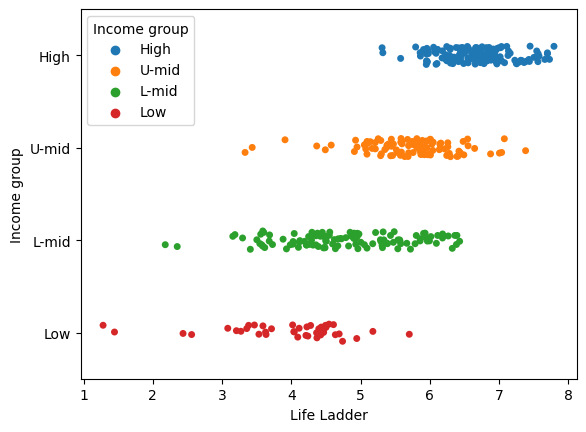

In [119]:
lifeladder_only_df = pivot_df.loc[pivot_df['year']>2020,['Life Ladder','Income group']].dropna()
lifeladder_only_df = lifeladder_only_df.sort_values('Life Ladder', ascending=False)

sns.stripplot(lifeladder_only_df, x='Life Ladder',y='Income group',hue_order=incomes, hue='Income group')

In [120]:
#Generate correlation data for total, as well as separated by income group
corr_total_df = pivot_df.corr(numeric_only=True, min_periods = 30)
corr_income_dfs = []
for i in range(len(incomes)):
    corr_income_dfs.append(pivot_df.loc[pivot_df['Income group'] == incomes[i],:].corr(numeric_only=True))


In [121]:
#Create lifeladder (the main metric) dataframe that includes r-value against all metrics
lifeladder_df = pd.DataFrame(corr_total_df['Life Ladder'])
lifeladder_df.rename(columns={'Life Ladder':'Total corr'}, inplace=True)
#Remove correlation with itself
lifeladder_df = lifeladder_df.loc[lifeladder_df.index != 'Life Ladder']

#Add correlation value for each income group 
for df, income in zip(corr_income_dfs,incomes):    
    lifeladder_df = pd.merge(lifeladder_df,df['Life Ladder'],left_index=True,right_index=True,how='left')
    lifeladder_df.rename(columns={'Life Ladder': income + ' corr'}, inplace=True)

#Calculate # of pairwise datapoints used for each metric's correlation with life ladder, and add the counts into the lifeladder dataframe
lifeladder_count_df = pivot_df.loc[~pivot_df['Life Ladder'].isna()].groupby('Income group').count().transpose()
lifeladder_count_df.columns = [col + ' count' for col in lifeladder_count_df.columns]
lifeladder_count_df['Total count'] = lifeladder_count_df.sum(axis=1)
lifeladder_df = pd.merge(lifeladder_df,lifeladder_count_df,left_index=True,right_index=True,how='left')
lifeladder_df


,Total corr,High corr,U-mid corr,L-mid corr,Low corr,High count,L-mid count,Low count,U-mid count,Total count
year,0.046846,0.016919,-0.006674,-0.107333,-0.140261,732,613,387,606,2338
AIDS estimated deaths (UNAIDS estimates),-0.294490,0.052289,-0.149482,-0.312180,-0.164663,201,245,162,231,839
ARI treatment (% of children under 5 taken to a health provider),0.359740,NaN,0.482411,0.138255,-0.055142,1,42,37,20,100
Access to clean fuels and technologies for cooking (% of population),0.715679,0.059450,0.192384,0.351700,0.202475,244,170,99,180,693
"Access to clean fuels and technologies for cooking, rural (% of rural population)",0.715599,0.084316,0.187940,0.228165,0.270245,244,170,99,180,693
...,...,...,...,...,...,...,...,...,...,...
total_damages_pct_gdp_all_disasters_excluding_earthquakes,-0.036618,0.077800,0.045083,0.114102,0.054965,347,382,276,344,1349
total_damages_pct_gdp_all_disasters_excluding_extreme_temperature,-0.027638,0.018424,0.068919,0.121847,-0.014949,325,370,278,333,1306
total_damages_pct_gdp_glacial_lake_outburst_flood,NaN,NaN,NaN,NaN,NaN,0,1,0,0,1
total_damages_pct_gdp_wet_mass_movement,0.030919,0.322144,-0.012170,0.291413,-0.070576,14,72,46,40,172


In [122]:
# Initialization of parameters prior to graphing
cols_to_analyze=50
columns = 3
target_column = 'Life Ladder'

#Extract top N (defined by cols_to_analyze) positively correlated metrics
top_pos_corrs = lifeladder_df.sort_values(by='Total corr',ascending=False).head(cols_to_analyze)

#Extract top N (defined by cols_to_analyze) negatively correlated metrics
top_neg_corrs = lifeladder_df.sort_values(by='Total corr',ascending=True).head(cols_to_analyze)

#Extract bottom N (defined by cols_to_analyze) correlated metrics
weak_corrs = lifeladder_df.loc[lifeladder_df.abs().sort_values(by='Total corr',ascending=True).head(cols_to_analyze).index,:]


In [123]:
def graph_correlations(corr_df, source_df, graphs_per_row, show_income_groups = False, show_linear = False, show_binomial = False, x_range = (1,8)):
    """
    Creates scatterplots with linear regression line based on provided data. 
    
    In: 
        corr_df (pd.DataFrame): Dataframe that includes all metrics to graph with the life ladder value. Should be a subset of lifeladder_df
        source_df (pd.DataFrame): Main dataframe that has all the datapoints. This should be pivot_df
        graphs_per_row (int): Decides how many graphs to include per row when plotting all the scatterplots
        show_income_group (bool): If set to true, the data points will be colored based on income level of the country, and also add 
            additional regression lines for each grouping
        show_linear (bool): If true, show linear regression line(s)
        show_binomial (bool): If true, show binomial regression line(s)
        x_range (int tuple): If set, specifies the range of x (life ladder) values to show on graph. Default is from 1 to 8
    Out: 
        Scatterplots with regresison line, with additional regression line for each income group if user put True for show_income_groups
        Number of scatterplots depends on number of metrics (rows) included in corr_df
    """
    fig, axes = plt.subplots(math.ceil(len(corr_df)/ graphs_per_row), graphs_per_row, figsize=(30,10 * math.ceil(len(corr_df)/graphs_per_row)))
    
    #If there is only one row in corr_df, then the "axes" is not an ndarray, which breaks the subsequent for loop to flatten the axes
    #Therefore, if it's one row then wrap it with a 2d ndarray
    if len(corr_df) ==1:
        axes = np.array([[axes]])
        
    for ax,corr_col in zip(axes.flatten(),corr_df.index):
        if (show_income_groups):
            sns.scatterplot(source_df,x=target_column,y=corr_col,hue='Income group', palette='tab10',hue_order=incomes, ax=ax)
        else:
            sns.scatterplot(source_df,x=target_column,y=corr_col,ax=ax)
        
        # Put # of data points and r-value to title
        n = corr_df.loc[corr_col,'Total count']
        r = round(corr_df.loc[corr_col,'Total corr'],4)
        ax.set_title("\n".join(wrap(f"{corr_col} (n={n}, r={r})", 50)),fontsize=20)
        ax.set_xlim(x_range[0],x_range[1]) # Highest world happiness score is less than 7, so limitting from 1 to 8
        ax.set_ylabel("")

        #Create temp dataframe for regression line calculation
        temp_df = source_df[['Income group',target_column,corr_col]].dropna()
        
        #Create a list of x values to be used when plotting regression lines
        plot_xs = np.arange(x_range[0],x_range[1]+0.1,0.2)
        
        
        #Linear Regression plotting for total
        if (show_linear):
            p = np.poly1d(np.polyfit(x=temp_df.loc[:,target_column],y=temp_df.loc[:,corr_col],deg=1))
            ax.plot(plot_xs, p(plot_xs),color='black',linewidth=2)

        # Binomial regression plotting for total
        if (show_binomial):
            p = np.poly1d(np.polyfit(x=temp_df.loc[:,target_column],y=temp_df.loc[:,corr_col],deg=2))
            ax.plot(plot_xs, p(plot_xs),color='black',linewidth=2, linestyle='dashed')

        
        
        if (show_income_groups):
            #Plot regression line for each income group (if data exists)
            for income, color in zip(incomes, ['blue','orange','green','red']):
                if (temp_df.loc[temp_df['Income group']==income,:].shape[0] > 0):                    
                    if (show_linear):
                        p = np.poly1d(np.polyfit(x=temp_df.loc[temp_df['Income group']==income,target_column],
                                                 y=temp_df.loc[temp_df['Income group']==income,corr_col],deg=1))
                        ax.plot(plot_xs, p(plot_xs),color=color,linewidth=1)

                    # Binomial regression plotting for total
                    if (show_binomial):
                        p = np.poly1d(np.polyfit(x=temp_df.loc[temp_df['Income group']==income,target_column],
                                                 y=temp_df.loc[temp_df['Income group']==income,corr_col],deg=2))
                        ax.plot(plot_xs, p(plot_xs),color=color,linewidth=1, linestyle='dashed')

                    
            #Add # of data points and r-value into the legend
            h,l = ax.get_legend_handles_labels()
            for i,income in zip(range(len(l)),incomes):
                n = corr_df.loc[corr_col,income+" count"]
                r = round(corr_df.loc[corr_col,income+" corr"],3)
                l[i] = f"{l[i]} (n={n}, r={r})"
            ax.legend(h,l, title = "Income Groups")
    


### Top positively correlating metrics

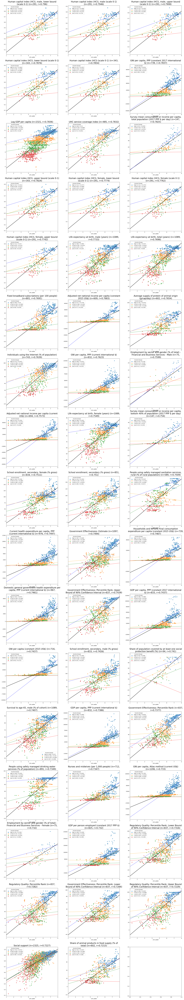

In [125]:

graph_correlations(top_pos_corrs, pivot_df, columns, show_income_groups = True, show_linear = True)

### Top negatively correlating metrics

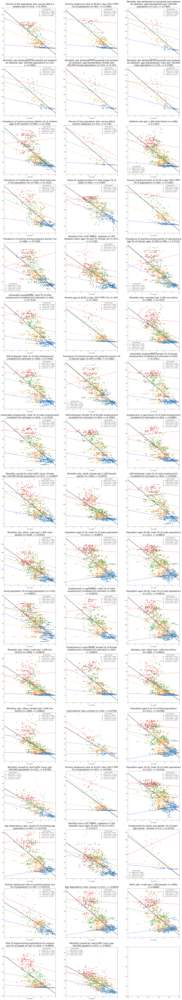

In [127]:
graph_correlations(top_neg_corrs, pivot_df, columns, True, show_linear = True)

### Bottom correlating metrics

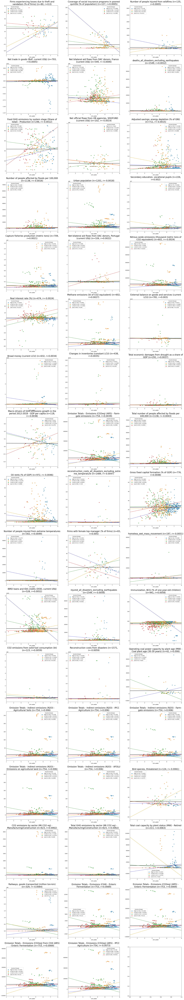

In [129]:
graph_correlations(weak_corrs, pivot_df, columns, True, show_linear = True)

### Top correlated metrics across income groups

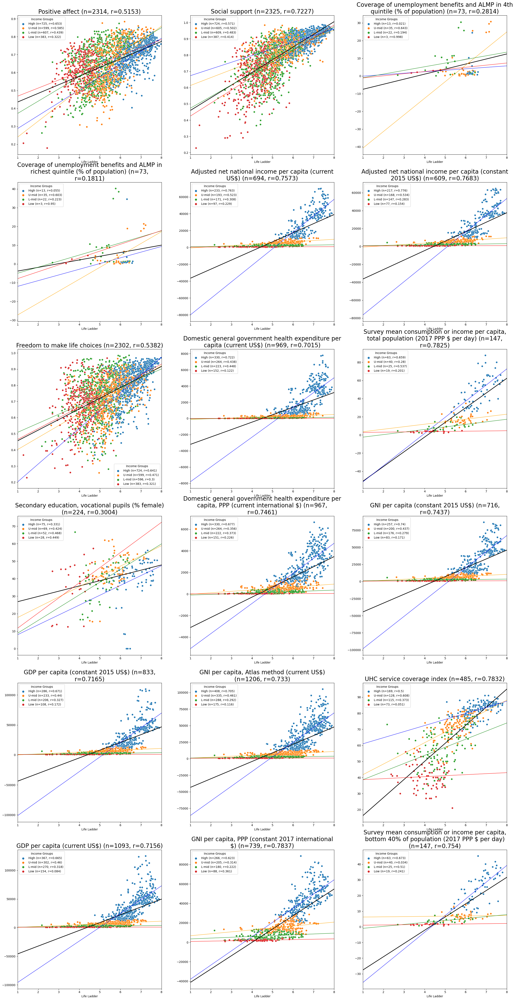

In [131]:
lifeladder_df['avg corr'] = lifeladder_df[[income + ' corr' for income in incomes]].mean(axis=1)

top_avg_pos_corrs = lifeladder_df.sort_values(by='avg corr',ascending=False).head(cols_to_analyze).dropna()
graph_correlations(top_avg_pos_corrs, pivot_df, columns, show_income_groups = True, show_linear = True)

## Analysis only with high income 

In [133]:
high_pivot_df = pivot_df.loc[pivot_df['Income group'] == 'High',:]
high_lifeladder_df = high_pivot_df.corr(numeric_only = True,min_periods=20)['Life Ladder']

high_lifeladder_df = pd.DataFrame(high_pivot_df.corr(numeric_only = True,min_periods=20)['Life Ladder'])
high_lifeladder_df.rename(columns={'Life Ladder':'Total corr'}, inplace=True)
#Remove correlation with itself
high_lifeladder_df = high_lifeladder_df.loc[high_lifeladder_df.index != 'Life Ladder']

high_lifeladder_df.sort_values(by='Total corr', ascending=False)

#Calculate # of pairwise datapoints used for each metric's correlation with life ladder, and add the counts into the lifeladder dataframe
high_lifeladder_count_df = high_pivot_df.loc[~high_pivot_df['Life Ladder'].isna()].count().to_frame(name='Total count')
high_lifeladder_df = pd.merge(high_lifeladder_df,high_lifeladder_count_df,left_index=True,right_index=True)



In [134]:
#Extract top N (defined by cols_to_analyze) positively correlated metrics
high_top_pos_corrs = high_lifeladder_df.sort_values(by='Total corr',ascending=False).head(cols_to_analyze)

#Extract top N (defined by cols_to_analyze) negatively correlated metrics
high_top_neg_corrs = high_lifeladder_df.sort_values(by='Total corr',ascending=True).head(cols_to_analyze)

#Extract bottom N (defined by cols_to_analyze) correlated metrics
high_weak_corrs = high_lifeladder_df.loc[high_lifeladder_df.abs().sort_values(by='Total corr',ascending=True).head(cols_to_analyze).index,:]


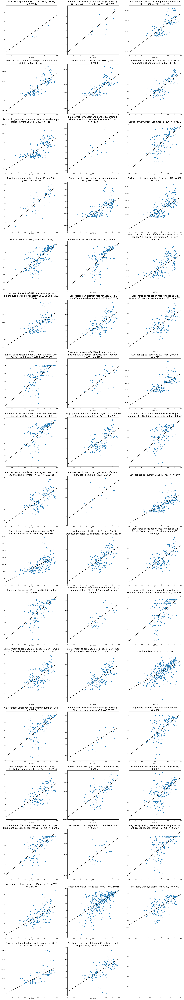

In [135]:
graph_correlations(high_top_pos_corrs, high_pivot_df, columns, show_income_groups = False, show_linear = True, x_range=(4,8))

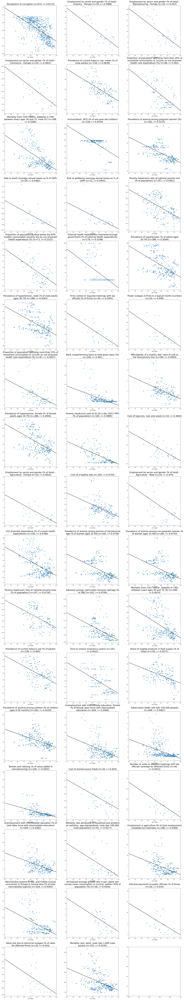

In [136]:
graph_correlations(high_top_neg_corrs, high_pivot_df, columns, show_income_groups = False, show_linear = True, x_range=(4,8))

## Analysis with OECD data
OECD data also has some metrics similar to WHP (e.g. life satisfaction). Doing extra analysis to see if there are additional insights. 

### Data setup
OECD data can be pulled via API. We will use pandasdmx + custom setup to pull data

In [139]:
import pandasdmx as sdmx
# Create new data source for pandasdmx, as OECD has a new API endpoint
NEW_OECD = {
  "id": "OECD.WISE.WDP",
  "documentation": "https://gitlab.algobank.oecd.org/public-documentation/dotstat-migration/-/raw/main/OECD_Data_API_documentation.pdf",
  "url": "https://sdmx.oecd.org/public/rest",
  "name": "OECD new",
  "supported": {"dataflow": True}
}

sdmx.add_source(NEW_OECD,override=True)

In [140]:
#PARAMETERS

# Year range to fetc the values from
OECD_years_from = 2016
OECD_years_to = 2022


In [141]:
#API initialize
resource_id = 'DSD_HSL@DF_HSL_CWB'
key='all'
oecd = sdmx.Request('OECD.WISE.WDP')
# Fetch data from OECD API for the years specified and store them to oecd_df
oecd_df_orig = None
for year in range(OECD_years_from, OECD_years_to+1):
    result = oecd.get(resource_type='data',resource_id=resource_id,key=key,params={'startPeriod':year, 'endPeriod':year})
    if oecd_df_orig is None:
        oecd_df_orig = result.to_pandas()
    else: 
        oecd_df_orig = pd.concat([oecd_df_orig, result.to_pandas()],axis=0)

#oecd_df is actually a series at this point. Convert to an actual dataframe
oecd_df_orig = pd.DataFrame(oecd_df_orig).reset_index()

In [142]:
#additionally, get code list from their API to map the code ID/values to meaningful names
result = oecd.get(resource_type='dataflow',resource_id=resource_id,version='1.0',params={'references': 'codelist'})

code_dict = sdmx.to_pandas(result)

#code_dict is actually a dictionary of dictionaries, so make it flat
column_map = {
    'SEX':'CL_SEX',
    'REF_AREA':'CL_REGIONAL',
    'MEASURE':'CL_MEASURE',
    'UNIT_MEASURE':'CL_UNIT_MEASURE',
    'AGE':'CL_AGE',
    'EDUCATION_LEV':'CL_EDUCATION_LEV_ISCED11',
    'DOMAIN':'CL_DOMAIN',
}
name_map_df = pd.DataFrame(columns=['type','key','name','parent'])

for key, value in code_dict.codelist.items():
#note that 'value' is actually a dictionary
    value['type'] = key
    value = value.reset_index().rename(columns={key:'key'})
    name_map_df = pd.concat([name_map_df,value],axis=0)


2024-05-10 14:54:14,133 pandasdmx.reader.sdmxml - DEBUG: Truncate sub-microsecond time in <Prepared>
DEBUG:pandasdmx.reader.sdmxml:Truncate sub-microsecond time in <Prepared>


In [143]:
#Keep the original OECD dataframe as is, and create new one with mapped values

oecd_df = oecd_df_orig.copy()
for key, value in column_map.items():
    map_df = name_map_df.loc[name_map_df['type']==value,['key','name']]
    oecd_df = oecd_df.merge(map_df,left_on=key,right_on='key',how='left')
    oecd_df.loc[:,key] = oecd_df.loc[:,'name']
    oecd_df.drop('key',axis=1,inplace=True)
    oecd_df.drop('name',axis=1,inplace=True)
    
#For this analysis, we will only use the total, so we are removing others, and also renaming columns
oecd_df = oecd_df.loc[(oecd_df['AGE'] == 'Total') & 
                      (oecd_df['SEX'] == 'Total') & 
                      (oecd_df['EDUCATION_LEV'] == 'Total')
                      ,['REF_AREA','MEASURE','TIME_PERIOD','value']]
oecd_df.rename(columns={'REF_AREA':'country', 'MEASURE':'series','TIME_PERIOD':'year'},inplace=True)
oecd_df['source']='OECD'
oecd_df['year'] = pd.to_numeric(oecd_df['year'])

#OECD document uses "Korea" for South Korea. Renaming
oecd_df.loc[oecd_df['country']=='Korea','country'] = 'South Korea'

In [144]:
#Create a pivot table and add life ladder to the mix
oecd_pivot_df = oecd_df.pivot_table(columns=['series'],index=['country','year'],values=['value'])
oecd_pivot_df.columns = [i[1] for i in oecd_pivot_df.columns]
oecd_pivot_df = oecd_pivot_df.reset_index()
#pivot_df = pivot_df.dropna(subset=pivot_df.columns,how='all')
#Add country classification


oecd_pivot_df = pd.merge(oecd_pivot_df,pivot_df[['country','year','Life Ladder','Income group']],on=['country','year'],how='left')


### Analysis

In [146]:
#Income group included in the data
oecd_pivot_df[['country','Income group']].drop_duplicates()['Income group'].value_counts()

High     33
U-mid     6
Name: Income group, dtype: int64

In [147]:
#Create correlation dataframe using Life Ladder data

oecd_lifeladder_df = pd.DataFrame(oecd_pivot_df.corr(numeric_only = True,min_periods=20)['Life Ladder'])
oecd_lifeladder_df.rename(columns={'Life Ladder':'Total corr'}, inplace=True)
#Remove correlation with itself
oecd_lifeladder_df = oecd_lifeladder_df.loc[oecd_lifeladder_df.index != 'Life Ladder']

oecd_lifeladder_df.sort_values(by='Total corr', ascending=False)

#Calculate # of pairwise datapoints used for each metric's correlation with life ladder, and add the counts into the lifeladder dataframe
oecd_lifeladder_count_df = oecd_pivot_df.loc[~oecd_pivot_df['Life Ladder'].isna()].count().to_frame(name='Total count')
oecd_lifeladder_df = pd.merge(oecd_lifeladder_df,oecd_lifeladder_count_df,left_index=True,right_index=True)


In [148]:
oecd_lifeladder_df.sort_values(by='Total corr',ascending=False)

,Total corr,Total count
Average annual gross earnings,0.728439,199
Life satisfaction,0.708870,71
Social support,0.670575,255
Employment rate,0.659250,230
Satisfaction with time use,0.609589,28
...,...,...
Not having a say in government,NaN,3
Time off,NaN,4
Time spent in social interactions,NaN,4
Top adult literacy scores decile,NaN,3


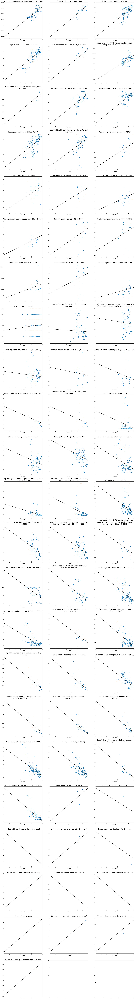

In [149]:

graph_correlations(oecd_lifeladder_df.sort_values(by='Total corr',ascending=False), oecd_pivot_df, columns, show_income_groups = False, show_linear = True)

## (Stretch) Correlation analysis per country

In [151]:
lifeladder_country_df = lifeladder_df.copy()
countries = pivot_df.loc[~pivot_df['Life Ladder'].isna(),'country'].unique()

#Calculate correlation per country
corr_country_dfs = []
for i in range(len(countries)):
    corr_country_dfs.append(pivot_df.loc[pivot_df['country'] == countries[i],:].corr(min_periods=5,numeric_only=True))

for df, country in zip(corr_country_dfs,countries):    
    lifeladder_country_df = pd.merge(lifeladder_country_df,df['Life Ladder'],left_index=True,right_index=True,how='left')
    lifeladder_country_df.rename(columns={'Life Ladder': country}, inplace=True)



In [152]:
lifeladder_country_df

,Total corr,High corr,U-mid corr,L-mid corr,Low corr,High count,L-mid count,Low count,U-mid count,Total count,...,United Arab Emirates,United Kingdom,United States,Uruguay,Uzbekistan,Venezuela,Vietnam,Yemen,Zambia,Zimbabwe
year,0.046846,0.016919,-0.006674,-0.107333,-0.140261,732,613,387,606,2338,...,-0.396679,-0.164520,-0.822455,0.727080,0.805778,-0.701957,0.436241,-0.621977,-0.632407,-0.425484
AIDS estimated deaths (UNAIDS estimates),-0.294490,0.052289,-0.149482,-0.312180,-0.164663,201,245,162,231,839,...,NaN,NaN,0.531988,-0.405517,-0.349217,NaN,NaN,NaN,0.618123,0.915730
ARI treatment (% of children under 5 taken to a health provider),0.359740,NaN,0.482411,0.138255,-0.055142,1,42,37,20,100,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Access to clean fuels and technologies for cooking (% of population),0.715679,0.059450,0.192384,0.351700,0.202475,244,170,99,180,693,...,NaN,NaN,NaN,NaN,0.129822,NaN,NaN,NaN,0.372927,-0.733122
"Access to clean fuels and technologies for cooking, rural (% of rural population)",0.715599,0.084316,0.187940,0.228165,0.270245,244,170,99,180,693,...,NaN,NaN,NaN,NaN,-0.136988,NaN,NaN,NaN,0.634321,-0.737415
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
total_damages_pct_gdp_all_disasters_excluding_earthquakes,-0.036618,0.077800,0.045083,0.114102,0.054965,347,382,276,344,1349,...,NaN,-0.427387,-0.329298,-0.090416,NaN,0.760993,-0.403259,-0.513149,NaN,0.110257
total_damages_pct_gdp_all_disasters_excluding_extreme_temperature,-0.027638,0.018424,0.068919,0.121847,-0.014949,325,370,278,333,1306,...,NaN,-0.426202,-0.330356,-0.212057,NaN,0.760993,-0.403259,-0.513149,NaN,0.110257
total_damages_pct_gdp_glacial_lake_outburst_flood,NaN,NaN,NaN,NaN,NaN,0,1,0,0,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
total_damages_pct_gdp_wet_mass_movement,0.030919,0.322144,-0.012170,0.291413,-0.070576,14,72,46,40,172,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [153]:
avg_corr_df = lifeladder_country_df.iloc[:,10:].mean(axis=1).sort_values(ascending=False).to_frame(name='avg corr')
avg_corr_df = pd.merge(avg_corr_df,lifeladder_country_df.iloc[:,10:].count(axis=1).to_frame(name='corr count'),left_index=True, right_index=True)
avg_corr_df = pd.merge(avg_corr_df,lifeladder_country_df.iloc[:,10:].std(axis=1).to_frame(name='corr std'),left_index=True, right_index=True)

avg_corr_df

,avg corr,corr count,corr std
Operating coal power capacity by plant type (MW) - Plant Type (IGCC),1.0,1,NaN
affected_rate_per_100k_glacial_lake_outburst_flood,1.0,1,NaN
Operating coal power capacity by plant type (MW) - Plant Type (Subcritical/CCS),1.0,1,NaN
affected_glacial_lake_outburst_flood,1.0,1,NaN
total_affected_rate_per_100k_glacial_lake_outburst_flood,1.0,1,NaN
...,...,...,...
homeless_rate_per_100k_glacial_lake_outburst_flood,NaN,0,NaN
insured_damages_glacial_lake_outburst_flood,NaN,0,NaN
reconstruction_costs_glacial_lake_outburst_flood,NaN,0,NaN
reconstruction_costs_wet_mass_movement,NaN,0,NaN


In [154]:
show(lifeladder_country_df[lifeladder_country_df.index=='Positive affect'].transpose())

## Misc

<AxesSubplot: xlabel='Life Ladder', ylabel='Current health expenditure per capita (current US$)'>

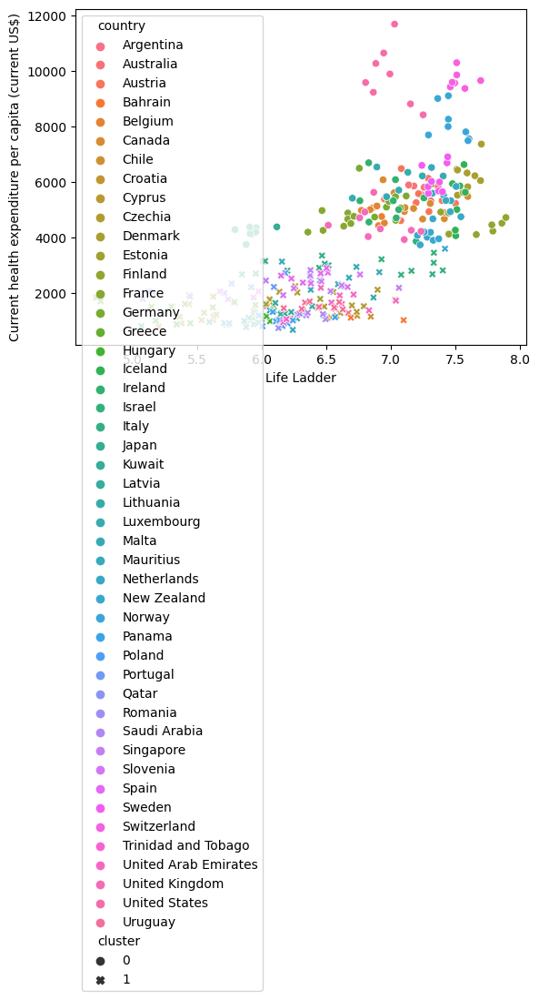

In [156]:

from sklearn.cluster import KMeans


temp_df = high_pivot_df[['country','year','Life Ladder','Current health expenditure per capita (current US$)']].dropna()
k = 2

kmeans = KMeans(n_clusters=k)

# Fit the model to the data (training)
kmeans.fit(temp_df[['Life Ladder','Current health expenditure per capita (current US$)']])

# Get the cluster labels for each data point
cluster_labels = kmeans.labels_

# # Create a scatter plot with colors based on cluster labels
# plt.scatter(temp_df['Life Ladder'], temp_df['Current health expenditure per capita (current US$)'], c=cluster_labels)

# # Add labels and title
# plt.xlabel('Life Ladder')
# plt.ylabel('Current health expenditure per capita (current US$)')
# plt.title('K-Means Clustering (2 Clusters)')

# Show the plot
temp_df['cluster'] = cluster_labels

sns.scatterplot(temp_df,x='Life Ladder',y='Current health expenditure per capita (current US$)',hue='country',style='cluster')